This notebook illustrates using clustering and our descriptors compounds.

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import plotly.express as px
import plotly.offline as pyo
import plotly.graph_objs as go
np.random.seed(1)
pyo.init_notebook_mode()



from sklearn.preprocessing import StandardScaler
from sklearn.cluster import KMeans
from sklearn.decomposition import PCA
from sklearn.metrics import silhouette_score
from yellowbrick.cluster import KElbowVisualizer
import lightgbm 
from sklearn.ensemble import GradientBoostingRegressor
 
import warnings
warnings.filterwarnings("ignore")

In [2]:
# import data ../../../data/final/clean_trial4.csv
data_ours = pd.read_csv("../../data/processed/trial4.csv")

In [3]:
data_trained = pd.read_csv('../../data/final/clean_trial4.csv')

In [4]:
# import data
data = pd.read_csv("../../data/processed/drug_bank_clean.csv")

In [5]:
data_trained

,logkpl,Compound,SMILES,Texpi,ALogp2,nAcid,nAromBond,ATSc2,ATSc3,ATSc4,...,nRings9,TopoPSA,VAdjMat,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,XLogP,Zagreb
0,-3.55,Urea,C(=O)(N)N,312,1.085972,0,0,-0.116019,0.023614,0.000000,...,0,69.11,2.584963,1.683013,6.732051,2.244017,4.488034,9.0,-1.686,12.0
1,-3.69,Urea,C(=O)(N)N,312,1.085972,0,0,-0.116019,0.023614,0.000000,...,0,69.11,2.584963,1.683013,6.732051,2.244017,4.488034,9.0,-1.686,12.0
2,-3.83,Urea,C(=O)(N)N,312,1.085972,0,0,-0.116019,0.023614,0.000000,...,0,69.11,2.584963,1.683013,6.732051,2.244017,4.488034,9.0,-1.686,12.0
3,-3.95,Urea,C(=O)(N)N,312,1.085972,0,0,-0.116019,0.023614,0.000000,...,0,69.11,2.584963,1.683013,6.732051,2.244017,4.488034,9.0,-1.686,12.0
4,-3.93,Urea,C(=O)(N)N,312,1.085972,0,0,-0.116019,0.023614,0.000000,...,0,69.11,2.584963,1.683013,6.732051,2.244017,4.488034,9.0,-1.686,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
412,-3.68,Methylglucose,COC(C(C=O)O)C(C(CO)O)O,310,5.177445,0,0,-0.149202,-0.333960,0.084389,...,0,107.22,4.584963,1.857097,14.920659,14.920659,0.000000,252.0,-2.806,54.0
413,-1.56,Eugenol,COC1=C(C=CC(=C1)CC=C)O,305,6.523427,0,6,-0.103526,-0.058044,0.090303,...,0,29.46,4.584963,1.952278,5.304497,5.304497,0.000000,204.0,2.556,54.0
414,-1.59,Eugenol,COC1=C(C=CC(=C1)CC=C)O,305,6.523427,0,6,-0.103526,-0.058044,0.090303,...,0,29.46,4.584963,1.952278,5.304497,5.304497,0.000000,204.0,2.556,54.0
415,-2.07,Methyl methanesulfonate,COS(=O)(=O)C,305,0.140400,0,0,-0.182756,0.082199,-0.044057,...,0,51.75,3.321928,1.744332,10.298097,7.194544,0.000000,28.0,-0.869,24.0


In [6]:
cols_trained_on = data_trained.drop(['logkpl', 'Compound', 'SMILES'], axis=1).columns

In [7]:
cols_trained_on

Index(['Texpi', 'ALogp2', 'nAcid', 'nAromBond', 'ATSc2', 'ATSc3', 'ATSc4',
       'ATSc5', 'ATSm1', 'BCUTw-1l',
       ...
       'nRings9', 'TopoPSA', 'VAdjMat', 'WTPT-2', 'WTPT-3', 'WTPT-4', 'WTPT-5',
       'WPATH', 'XLogP', 'Zagreb'],
      dtype='object', length=146)

In [8]:
data_ours.rename({'Compound': 'Name'}, axis=1, inplace=True)

In [9]:
data_ours

,logkpl,Name,SMILES,Texpi,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,...,MW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,-3.55,Urea,C(=O)(N)N,312,-1.0421,1.085972,13.1426,7.429172,0,0,...,60.055310,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0
1,-3.69,Urea,C(=O)(N)N,312,-1.0421,1.085972,13.1426,7.429172,0,0,...,60.055310,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0
2,-3.83,Urea,C(=O)(N)N,312,-1.0421,1.085972,13.1426,7.429172,0,0,...,60.055310,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0
3,-3.95,Urea,C(=O)(N)N,312,-1.0421,1.085972,13.1426,7.429172,0,0,...,60.055310,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0
4,-3.93,Urea,C(=O)(N)N,312,-1.0421,1.085972,13.1426,7.429172,0,0,...,60.055310,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
440,-3.68,Methylglucose,COC(C(C=O)O)C(C(CO)O)O,310,-2.2754,5.177445,42.1719,26.467102,0,0,...,194.182751,24.142258,1.857097,14.920659,14.920659,0.000000,252.0,18.0,-2.806,54.0
441,-1.56,Eugenol,COC1=C(C=CC(=C1)CC=C)O,305,2.5541,6.523427,48.5026,27.205516,0,6,...,164.201458,23.427332,1.952278,5.304497,5.304497,0.000000,204.0,15.0,2.556,54.0
442,-1.59,Eugenol,COC1=C(C=CC(=C1)CC=C)O,305,2.5541,6.523427,48.5026,27.205516,0,6,...,164.201458,23.427332,1.952278,5.304497,5.304497,0.000000,204.0,15.0,2.556,54.0
443,-2.07,Methyl methanesulfonate,COS(=O)(=O)C,305,-0.3747,0.140400,21.6541,12.826758,0,0,...,110.133416,10.465990,1.744332,10.298097,7.194544,0.000000,28.0,3.0,-0.869,24.0


In [10]:
set(data_ours.columns).difference(set(data.columns))

{'Texpi', 'logkpl'}

In [11]:
set(data.columns).difference(set(data_ours.columns))

set()

In [12]:
without_compound_ours = data_ours.drop(['Name','SMILES', 'logkpl', 'Texpi'], axis=1)
without_compound_ours.head(2)

,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,nAromBond,nAtom,ATSc1,ATSc2,...,MW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,-1.0421,1.085972,13.1426,7.429172,0,0,0,8,0.18481,-0.116019,...,60.05531,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0
1,-1.0421,1.085972,13.1426,7.429172,0,0,0,8,0.18481,-0.116019,...,60.05531,6.732051,1.683013,6.732051,2.244017,4.488034,9.0,0.0,-1.686,12.0


In [13]:
data.head(2)

,Name,SMILES,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,nAromBond,nAtom,...,MW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,Bivalirudin,CC[C@H](C)[C@H](NC(=O)[C@H](CCC(O)=O)NC(=O)[C@...,-5.0931,25.939668,534.3813,317.363434,6,18,18,293,...,2180.289181,306.516036,1.977523,153.54308,82.176355,71.366725,286334.0,230.0,-8.623,752.0
1,Leuprolide,CCNC(=O)[C@@H]1CCCN1C(=O)[C@H](CCCNC(N)=N)NC(=...,0.4325,0.187056,317.0896,187.074612,0,20,21,171,...,1209.400552,174.200943,2.002310,78.03037,30.548034,47.482336,46759.0,130.0,1.134,436.0


In [14]:
# getting all descriptors except compound name
without_compound = data.drop(['Name','SMILES'], axis=1)
without_compound.head(2)

,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,nAromBond,nAtom,ATSc1,ATSc2,...,MW,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb
0,-5.0931,25.939668,534.3813,317.363434,6,18,18,293,5.125258,-2.388694,...,2180.289181,306.516036,1.977523,153.54308,82.176355,71.366725,286334.0,230.0,-8.623,752.0
1,0.4325,0.187056,317.0896,187.074612,0,20,21,171,2.269431,-1.093604,...,1209.400552,174.200943,2.002310,78.03037,30.548034,47.482336,46759.0,130.0,1.134,436.0


In [15]:
import pickle

# Load the saved scaler object from the file
with open('../../models/scaler.pkl', 'rb') as file:
    prev_scaler = pickle.load(file)

# load the model 
loaded_model = pickle.load(open('../../models/GradientBoostingRegressor_model.sav', 'rb'))#LGBMRegressor_model

In [16]:
without_compound_pred = without_compound.copy()
without_compound_pred['Texpi'] = 310
without_compound_pred = without_compound_pred[cols_trained_on]

In [17]:
without_compound_pred

,Texpi,ALogp2,nAcid,nAromBond,ATSc2,ATSc3,ATSc4,ATSc5,ATSm1,BCUTw-1l,...,nRings9,TopoPSA,VAdjMat,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,XLogP,Zagreb
0,310,25.939668,6,18,-2.388694,-0.213216,2.137290,-3.517440,189.197005,11.693734,...,0.0,901.57,8.321928,1.977523,153.543080,82.176355,71.366725,286334.0,-8.623,752.0
1,310,0.187056,0,21,-1.093604,-0.058077,0.828090,-1.504583,102.053313,11.676546,...,0.0,429.04,7.523562,2.002310,78.030370,30.548034,47.482336,46759.0,1.134,436.0
2,310,3.513000,0,21,-1.251529,-0.162408,0.922017,-1.477058,108.322212,11.676546,...,0.0,495.89,7.584963,1.997902,88.729976,35.878826,52.851150,52357.0,-2.012,458.0
3,310,84.351366,0,40,-1.418733,-0.251865,1.465817,-2.357046,150.231130,11.676546,...,0.0,519.89,8.108524,1.997467,98.311965,40.550947,57.761019,148212.0,8.583,660.0
4,310,8.371185,0,12,-0.961833,-0.096634,0.700164,-1.326758,100.588859,11.693735,...,0.0,486.01,7.266787,1.991254,75.875569,30.211599,39.611320,28498.0,-1.437,360.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2288,310,13.664852,0,12,-0.106535,-0.004201,-0.002122,-0.003452,27.432911,11.692200,...,0.0,16.13,5.321928,2.008172,8.586421,0.000000,6.061732,718.0,3.238,92.0
2289,310,1.361889,1,6,-0.109937,0.028458,-0.112111,0.065810,12.323407,11.694272,...,0.0,57.53,4.321928,1.938482,7.332074,7.332074,0.000000,114.0,1.660,46.0
2290,310,26.316900,2,22,-0.543571,0.073913,-0.245256,0.268997,66.897876,11.695667,...,0.0,229.88,6.807355,2.012564,40.950978,22.037389,15.705335,9343.0,3.546,280.0
2291,310,13.659677,1,0,-0.093511,0.001419,-0.004306,-0.000223,14.548938,11.761711,...,0.0,37.30,4.584963,1.897053,4.763637,4.763637,0.000000,354.0,4.359,48.0


In [18]:
without_compound_pred.isna().sum().sum()

0

In [19]:
without_compound_pred_scaled = prev_scaler.transform(without_compound_pred)

In [20]:
pred = loaded_model.predict(without_compound_pred_scaled)
without_compound_pred['predicted_logkpl'] = pred

In [21]:
without_compound_pred

,Texpi,ALogp2,nAcid,nAromBond,ATSc2,ATSc3,ATSc4,ATSc5,ATSm1,BCUTw-1l,...,TopoPSA,VAdjMat,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,XLogP,Zagreb,predicted_logkpl
0,310,25.939668,6,18,-2.388694,-0.213216,2.137290,-3.517440,189.197005,11.693734,...,901.57,8.321928,1.977523,153.543080,82.176355,71.366725,286334.0,-8.623,752.0,-3.296702
1,310,0.187056,0,21,-1.093604,-0.058077,0.828090,-1.504583,102.053313,11.676546,...,429.04,7.523562,2.002310,78.030370,30.548034,47.482336,46759.0,1.134,436.0,-3.441618
2,310,3.513000,0,21,-1.251529,-0.162408,0.922017,-1.477058,108.322212,11.676546,...,495.89,7.584963,1.997902,88.729976,35.878826,52.851150,52357.0,-2.012,458.0,-3.396198
3,310,84.351366,0,40,-1.418733,-0.251865,1.465817,-2.357046,150.231130,11.676546,...,519.89,8.108524,1.997467,98.311965,40.550947,57.761019,148212.0,8.583,660.0,-3.797909
4,310,8.371185,0,12,-0.961833,-0.096634,0.700164,-1.326758,100.588859,11.693735,...,486.01,7.266787,1.991254,75.875569,30.211599,39.611320,28498.0,-1.437,360.0,-3.557337
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2288,310,13.664852,0,12,-0.106535,-0.004201,-0.002122,-0.003452,27.432911,11.692200,...,16.13,5.321928,2.008172,8.586421,0.000000,6.061732,718.0,3.238,92.0,-1.735903
2289,310,1.361889,1,6,-0.109937,0.028458,-0.112111,0.065810,12.323407,11.694272,...,57.53,4.321928,1.938482,7.332074,7.332074,0.000000,114.0,1.660,46.0,-2.295271
2290,310,26.316900,2,22,-0.543571,0.073913,-0.245256,0.268997,66.897876,11.695667,...,229.88,6.807355,2.012564,40.950978,22.037389,15.705335,9343.0,3.546,280.0,-3.161412
2291,310,13.659677,1,0,-0.093511,0.001419,-0.004306,-0.000223,14.548938,11.761711,...,37.30,4.584963,1.897053,4.763637,4.763637,0.000000,354.0,4.359,48.0,-2.701386


In [22]:
# scaling our data by using standard scaler
scaler = StandardScaler()
X_scaled = scaler.fit_transform(without_compound)

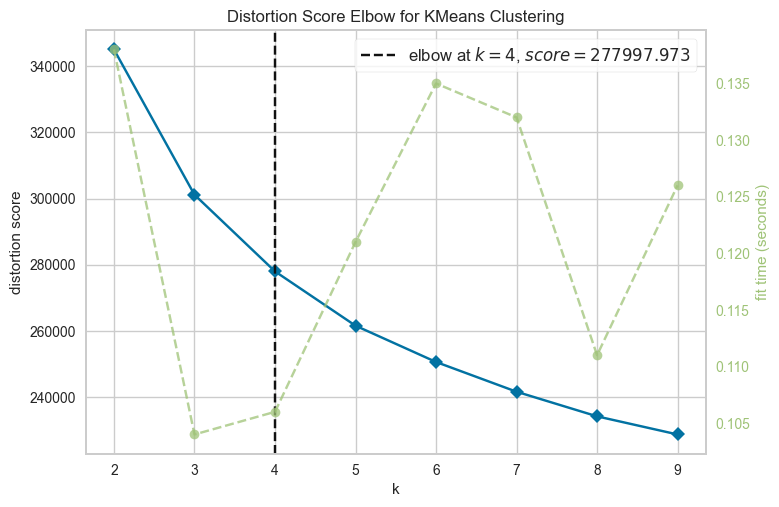

<Axes: title={'center': 'Distortion Score Elbow for KMeans Clustering'}, xlabel='k', ylabel='distortion score'>

In [23]:
np.random.seed(1)

# Instantiate the KMeans model
kmeans_model = KMeans()

# Instantiate the KElbowVisualizer
elbow_visualizer = KElbowVisualizer(kmeans_model, k=(2, 10))

# Fit the visualizer to the data
elbow_visualizer.fit(X_scaled)

# Visualize the elbow plot
elbow_visualizer.show()

In [24]:
sns.set()

Cluster 2 Sillhoute Score 0.6043792495047846
Cluster 3 Sillhoute Score 0.4619443890750979
Cluster 4 Sillhoute Score 0.31979315571976513
Cluster 5 Sillhoute Score 0.34654700833241603
Cluster 6 Sillhoute Score 0.24531960509792472
Cluster 7 Sillhoute Score 0.17948322690052035
Cluster 8 Sillhoute Score 0.18221514014234122
Cluster 9 Sillhoute Score 0.15589704633380216
Cluster 10 Sillhoute Score 0.1426879177812176
Cluster 11 Sillhoute Score 0.14067423166800858
Cluster 12 Sillhoute Score 0.08786122071678104
Cluster 13 Sillhoute Score 0.07332707600317155
Cluster 14 Sillhoute Score 0.1373279063608347
Cluster 15 Sillhoute Score 0.04612262167909179
Cluster 16 Sillhoute Score 0.025204702475498275
Cluster 17 Sillhoute Score 0.02190702352470605
Cluster 18 Sillhoute Score -0.0542486439656733
Cluster 19 Sillhoute Score -0.010765161332924976


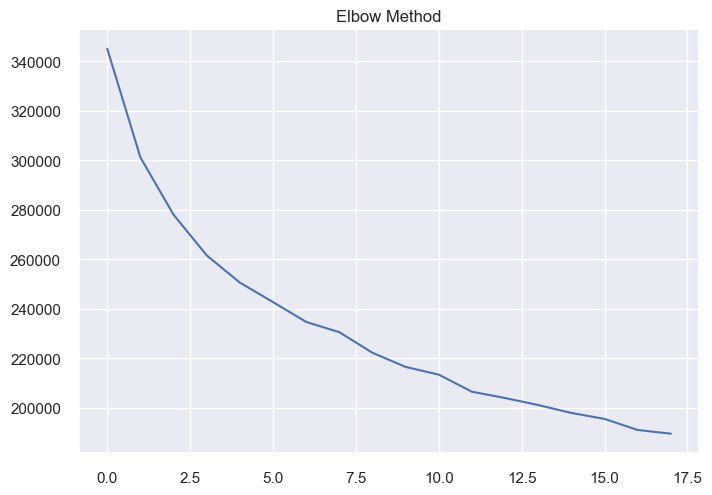

In [25]:
# elbow method
n_clusters = 20
cost = []
for i in range(2, n_clusters):
    kmean= KMeans(i, n_init=10, max_iter=1000)
    kmean.fit(X_scaled)
    labels = kmean.labels_
    
    cost.append(kmean.inertia_)
    print("Cluster {} Sillhoute Score {}".format(i, silhouette_score(without_compound, labels)))  

plt.title("Elbow Method")
plt.plot(cost, 'bx-');

In [26]:
kmean = KMeans(4, n_init=10, max_iter=1000)
kmean.fit(X_scaled)
labels = kmean.labels_

In [27]:
# adding clusters to our data
clusters = pd.concat([without_compound, pd.DataFrame({'cluster': labels})], axis=1)
clusters.head()

,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,nAromBond,nAtom,ATSc1,ATSc2,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,cluster
0,-5.0931,25.939668,534.3813,317.363434,6,18,18,293,5.125258,-2.388694,...,306.516036,1.977523,153.543080,82.176355,71.366725,286334.0,230.0,-8.623,752.0,3
1,0.4325,0.187056,317.0896,187.074612,0,20,21,171,2.269431,-1.093604,...,174.200943,2.002310,78.030370,30.548034,47.482336,46759.0,130.0,1.134,436.0,3
2,-1.8743,3.513000,325.6625,190.878612,0,20,21,175,2.635543,-1.251529,...,181.809125,1.997902,88.729976,35.878826,52.851150,52357.0,134.0,-2.012,458.0,3
3,9.1843,84.351366,493.8733,292.709055,0,36,40,266,3.021552,-1.418733,...,261.668224,1.997467,98.311965,40.550947,57.761019,148212.0,208.0,8.583,660.0,3
4,-2.8933,8.371185,269.4076,154.458752,0,12,12,138,2.148910,-0.961833,...,147.352827,1.991254,75.875569,30.211599,39.611320,28498.0,110.0,-1.437,360.0,3


In [28]:
silhouette_score(without_compound, labels)

0.3208684487799544

### All features

Explained variance ratio [0.34087863 0.09107553]

nSum of Explained variance ratio 0.4319541614805295

Columns chosen by PCA {'PC1': 'Zagreb', 'PC2': 'khs.ssssC'}


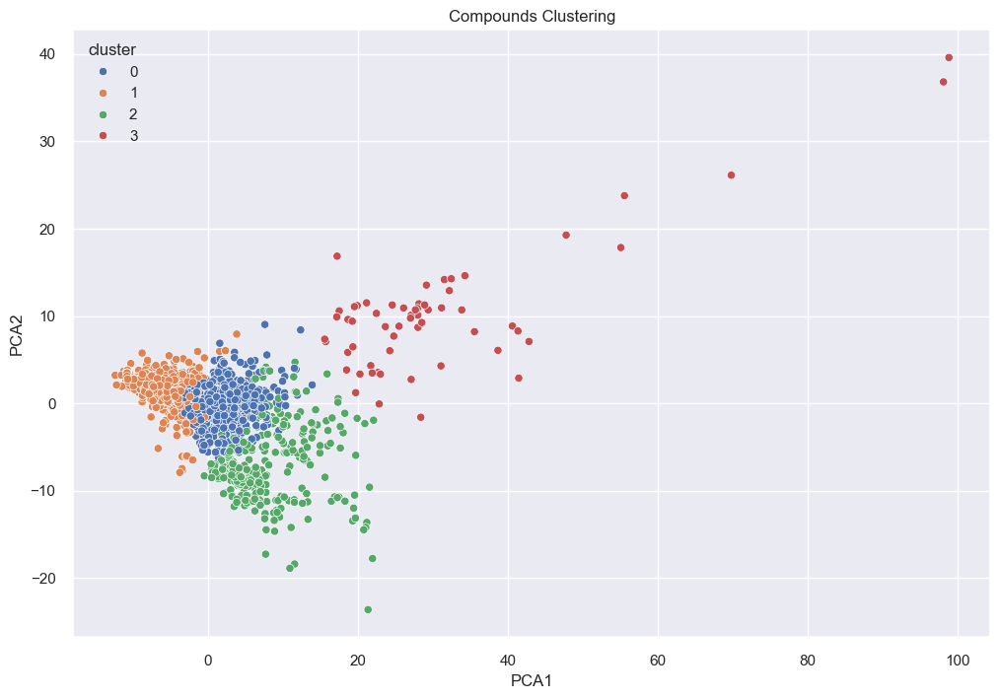

In [29]:
# using pca with 2 components to visualize our scaled data with clusters
components = 2

# initilizing and fitting the pca
pca = PCA(n_components=components)
X_pca = pca.fit_transform(X_scaled)

# making dataframe for our pca components
pca_df = pd.DataFrame(X_pca, columns=['PCA1','PCA2'])

# adding cluster assignment
pca_df['cluster'] = pd.Categorical(kmean.labels_)

# adding compound name to this dataframe
# pca_df['compound'] = data['Name']

# get the index of the most important feature on EACH component i.e. largest absolute value
most_important = [np.abs(pca.components_[i]).argmax() for i in range(components)]

# columns/ features of our data
initial_feature_names = without_compound.columns

# get the names
most_important_names = [initial_feature_names[most_important[i]] for i in range(components)]

# using LIST COMPREHENSION HERE AGAIN
dic = {'PC{}'.format(i + 1): most_important_names[i] for i in range(components)}

# explained variance
print("Explained variance ratio", pca.explained_variance_ratio_)
print("\nnSum of Explained variance ratio", pca.explained_variance_ratio_.sum())
print("\nColumns chosen by PCA", dic)


# Adjust the figure size
plt.figure(figsize=(12, 8))
# Create the scatterplot using Seaborn
sns.scatterplot(data=pca_df, x='PCA1', y='PCA2', hue="cluster")

# Set the plot title
plt.title("Compounds Clustering")


# Show the plot
plt.show()

In [30]:
pca_df['pred'] = without_compound_pred['predicted_logkpl']

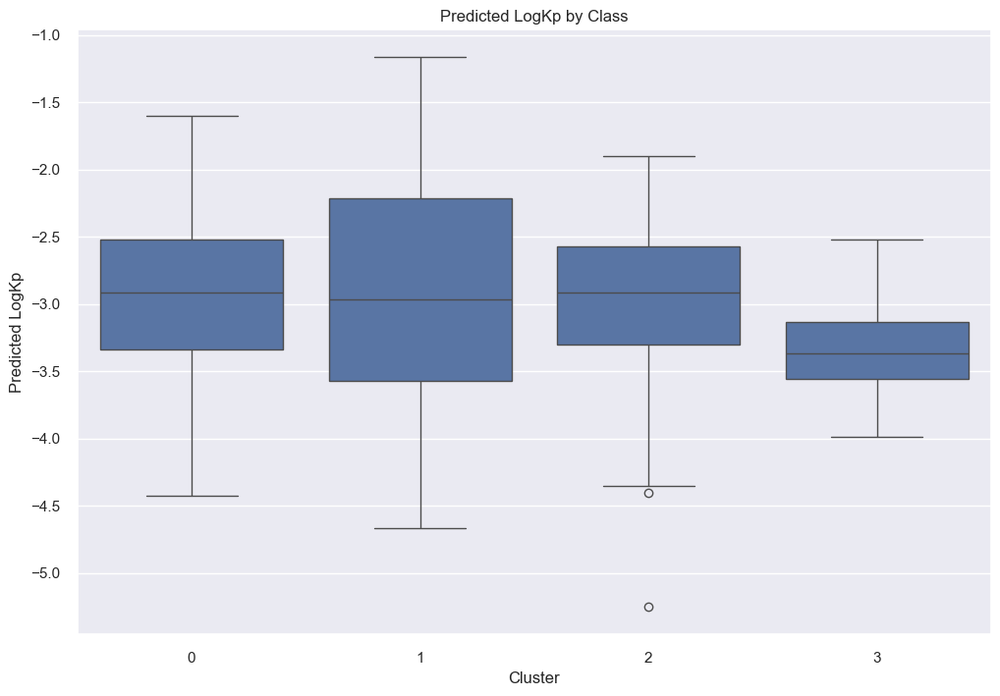

In [31]:
plt.figure(figsize=(12, 8))
sns.boxplot(data=pca_df, x='cluster', y='pred')
plt.title("Predicted LogKp by Class")
plt.ylabel("Predicted LogKp")
plt.xlabel("Cluster")
plt.show()

In [32]:
pca_df['Compound'] = "DrugBank"

In [33]:
np.random.seed(1)

x_scaled_ours = scaler.transform(without_compound_ours)
pca_ours = pca.transform(x_scaled_ours)
# making dataframe for our pca components
pca_df_ours = pd.DataFrame(pca_ours, columns=['PCA1','PCA2'])
pca_df_ours['Compound'] = "Ours" 

In [34]:
all_pca = pd.concat([pca_df, pca_df_ours], axis=0)

In [35]:
all_pca['Compound'].unique()

array(['DrugBank', 'Ours'], dtype=object)

Text(0.5, 1.0, 'Compounds Clustering')

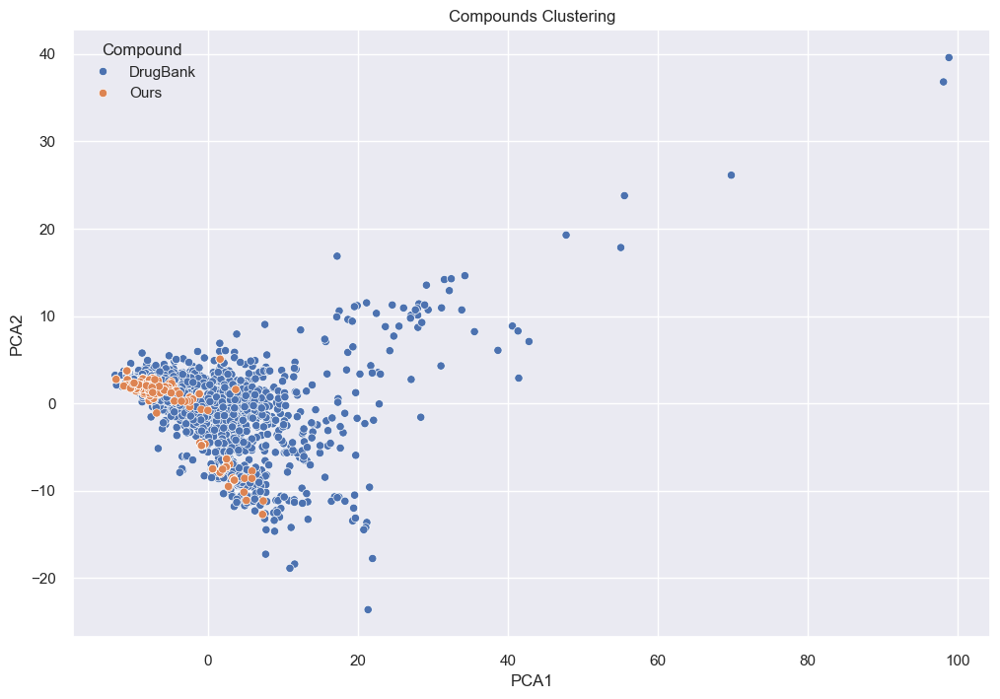

In [36]:
plt.figure(figsize=(12, 8))
# Create the scatterplot using Seaborn
sns.scatterplot(data=all_pca, x='PCA1', y='PCA2', hue="Compound")

# Set the plot title
plt.title("Compounds Clustering")

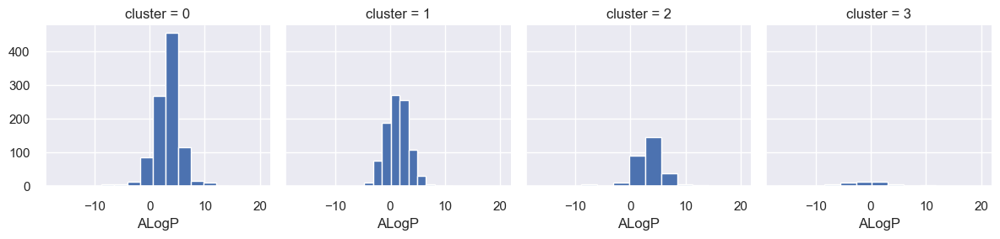

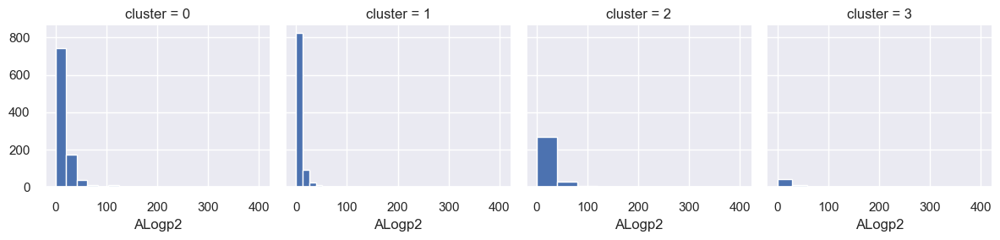

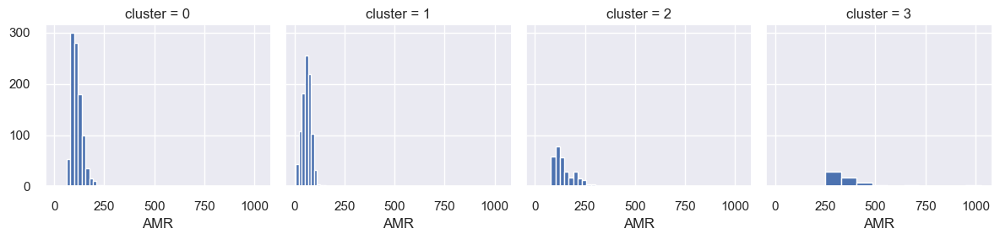

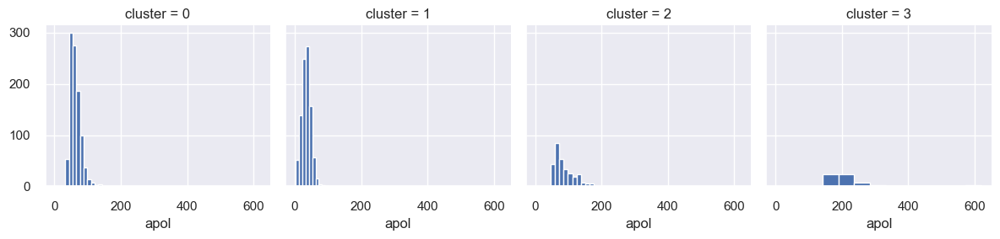

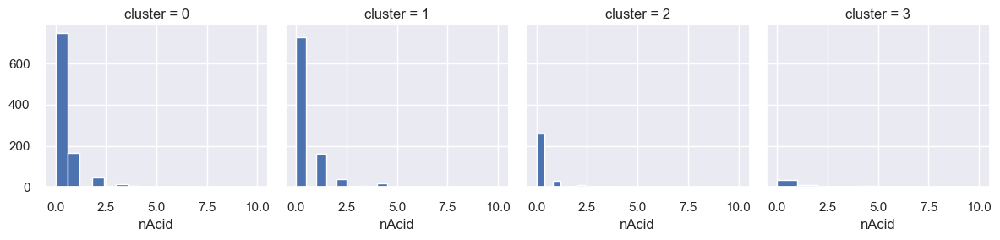

...

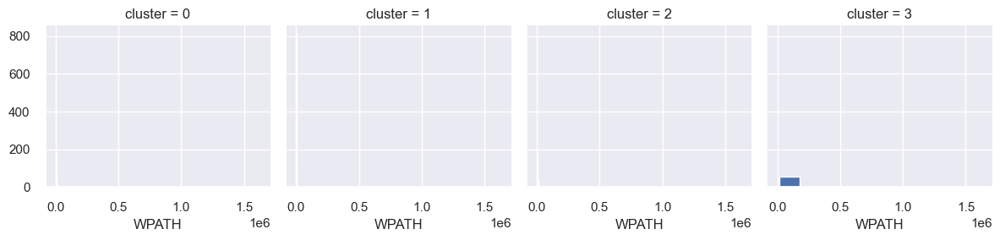

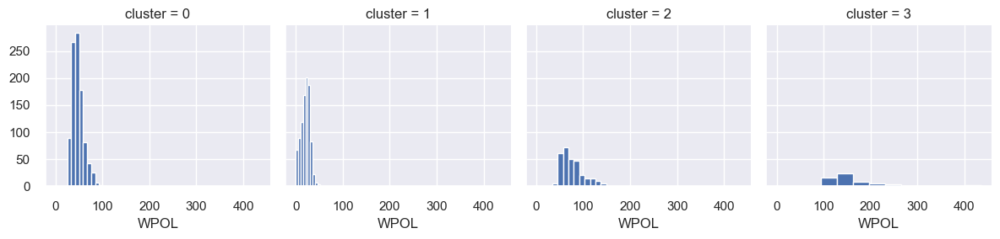

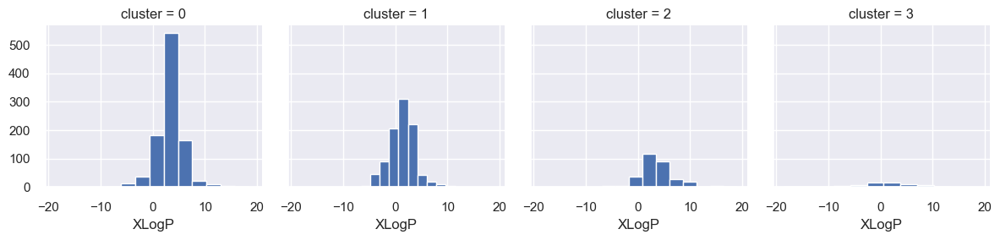

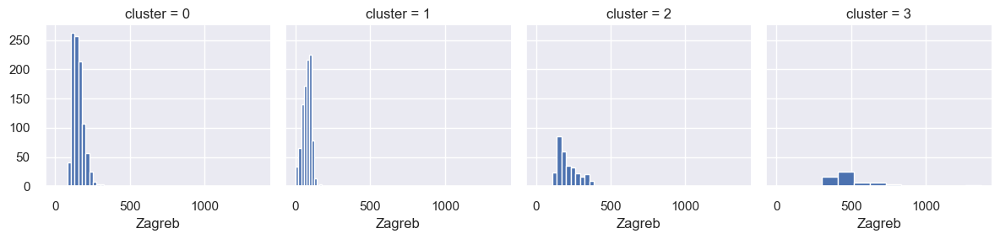

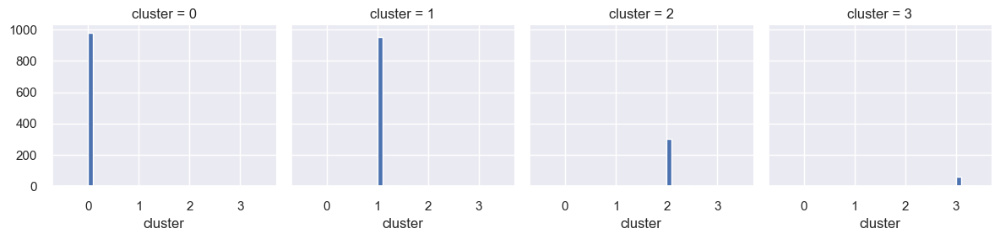

In [37]:
for c in clusters:
    grid = sns.FacetGrid(clusters, col="cluster")
    grid.map(plt.hist, c)
    plt.show()

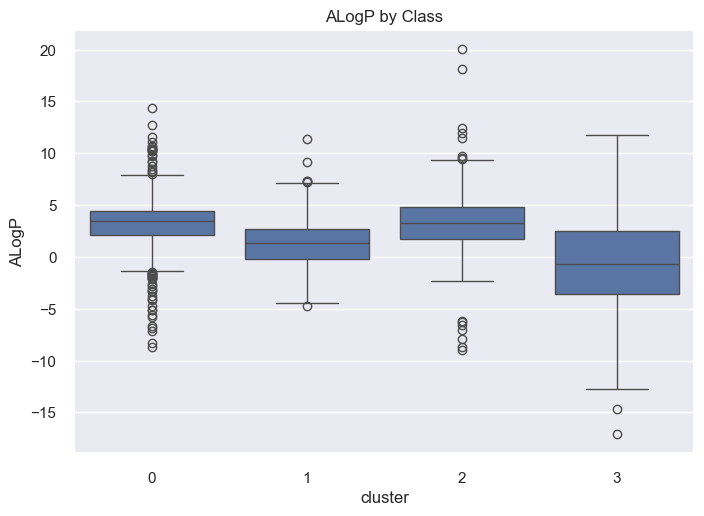

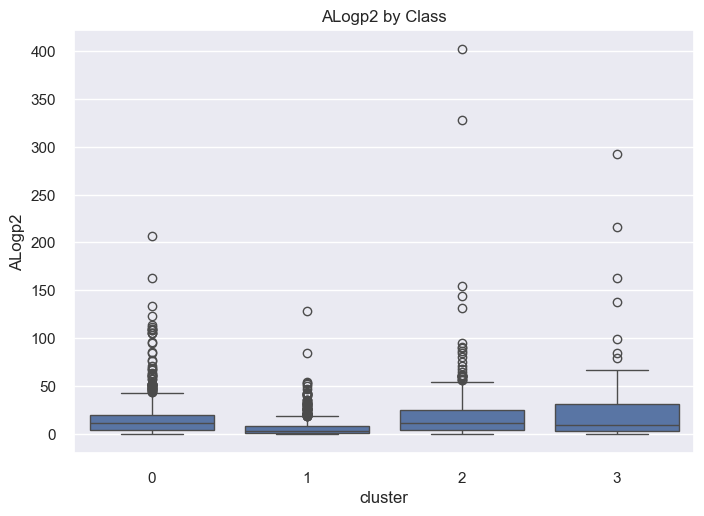

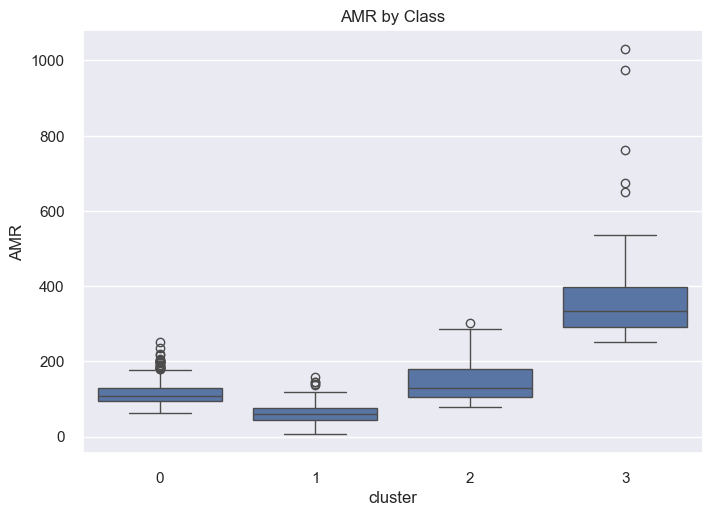

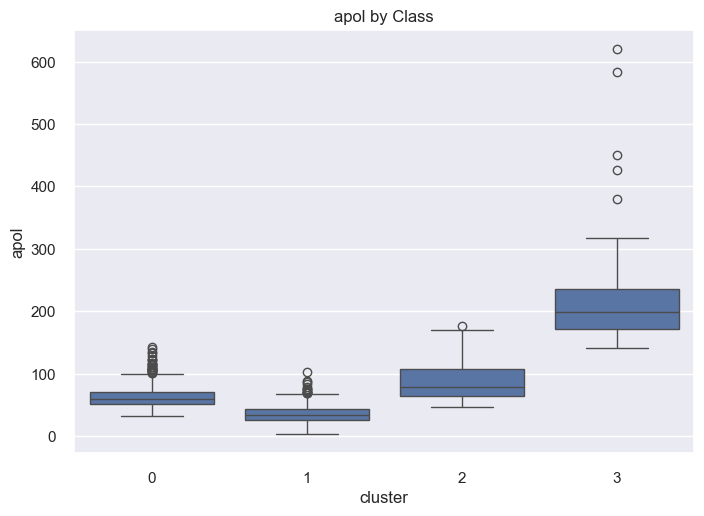

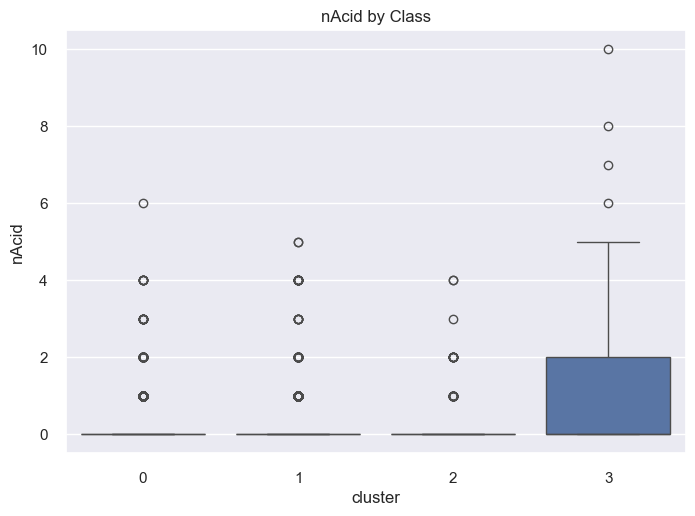

...

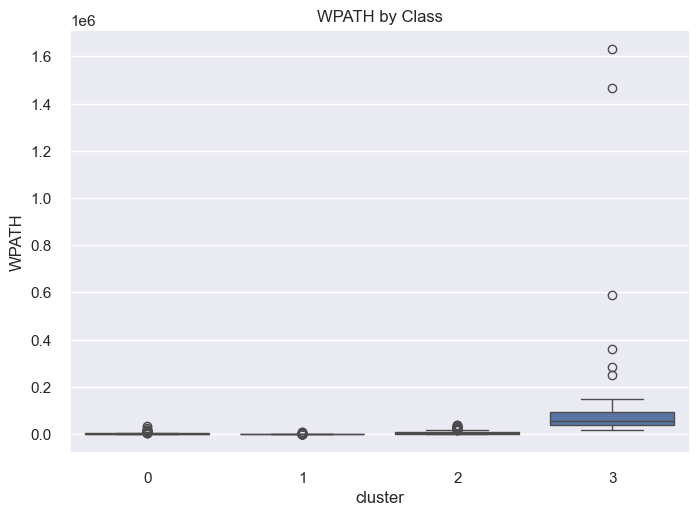

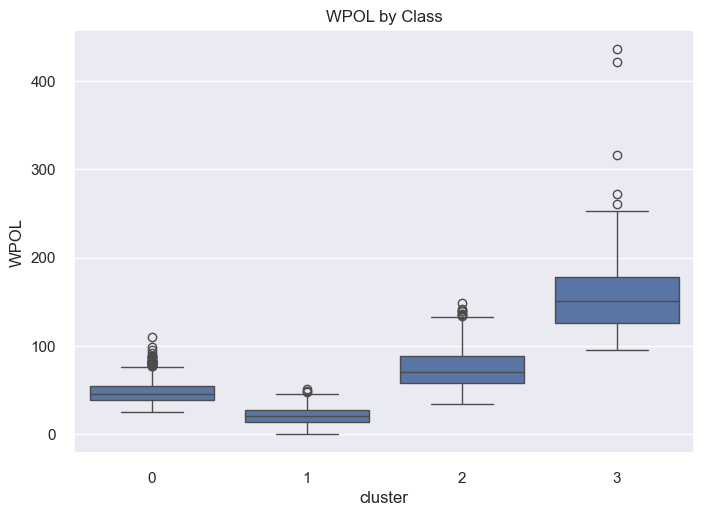

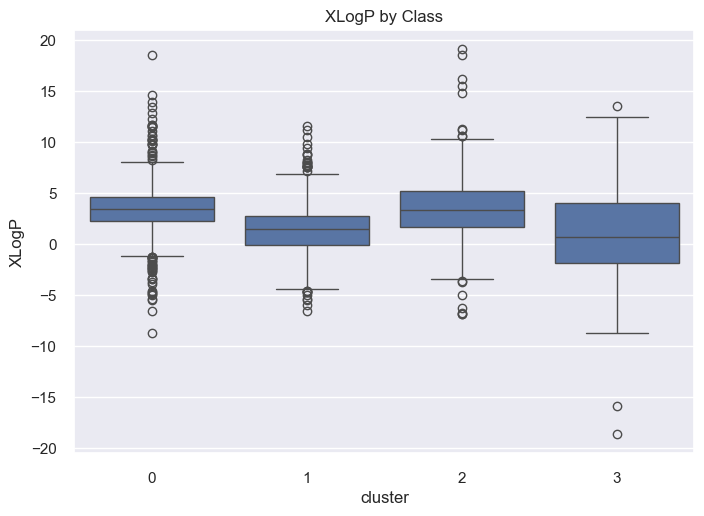

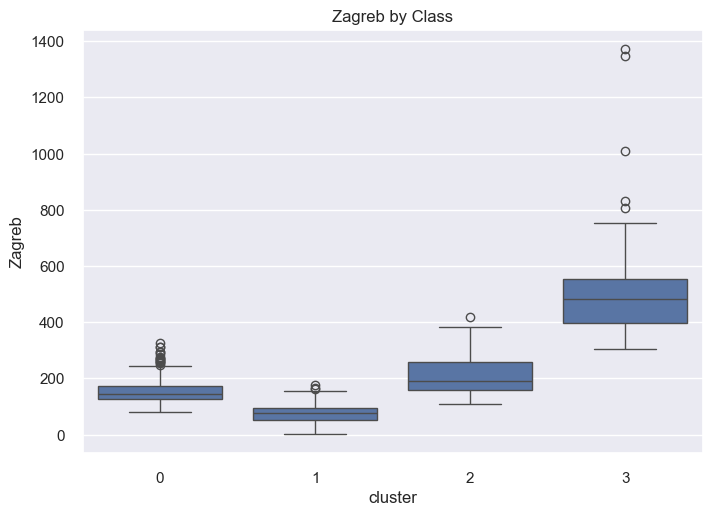

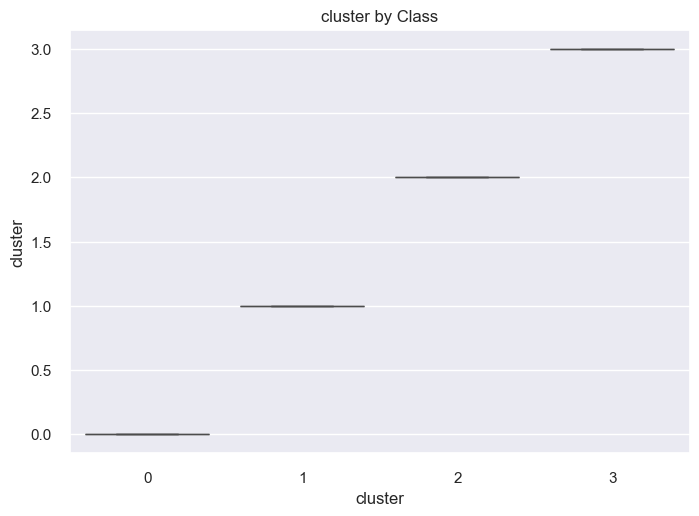

In [38]:
for col in clusters.columns:
    if col == "cluster":
        pass
    sns.boxplot(data=clusters, x='cluster', y=col)
    plt.title("{} by Class".format(col))
    plt.show()

### 99% of Components

In [39]:
# using pca with 2 components to visualize our scaled data with clusters
components = 0.99

# initilizing and fitting the pca
pca = PCA(n_components=components)
X_pca = pca.fit_transform(X_scaled)
pca.n_components_

82

In [40]:
kmean = KMeans(4, n_init=10, max_iter=1000)
kmean.fit(X_pca)
labels = kmean.labels_

In [41]:
silhouette_score(without_compound, labels)

0.3260162289952318

Explained variance ratio [0.34426944 0.09198149]

nSum of Explained variance ratio 0.4362509268237968

Columns chosen by PCA {'PC1': 'ALogP', 'PC2': 'ALogp2'}


Text(0.5, 1.0, 'Compounds Clustering - All Features')

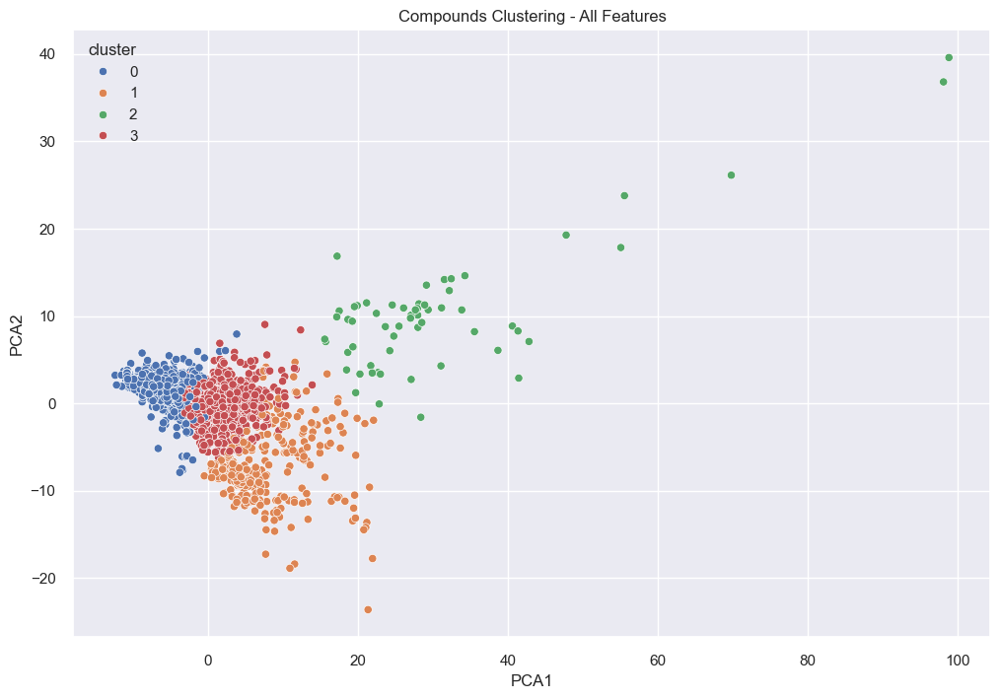

In [42]:
# using pca with 2 components to visualize our scaled data with clusters
components = 2

# initilizing and fitting the pca
pca = PCA(n_components=components)
X_pca = pca.fit_transform(X_pca)

# making dataframe for our pca components
pca_df = pd.DataFrame(X_pca, columns=['PCA1','PCA2'])

# adding cluster assignment
pca_df['cluster'] = pd.Categorical(kmean.labels_)

# adding compound name to this dataframe
# pca_df['compound'] = data['Name']

# get the index of the most important feature on EACH component i.e. largest absolute value
most_important = [np.abs(pca.components_[i]).argmax() for i in range(components)]

# columns/ features of our data
initial_feature_names = without_compound.columns

# get the names
most_important_names = [initial_feature_names[most_important[i]] for i in range(components)]

# using LIST COMPREHENSION HERE AGAIN
dic = {'PC{}'.format(i + 1): most_important_names[i] for i in range(components)}

# explained variance
print("Explained variance ratio", pca.explained_variance_ratio_)
print("\nnSum of Explained variance ratio", pca.explained_variance_ratio_.sum())
print("\nColumns chosen by PCA", dic)


pca_df
# Adjust the figure size
plt.figure(figsize=(12, 8))
# Create the scatterplot using Seaborn
sns.scatterplot(data=pca_df, x='PCA1', y='PCA2', hue="cluster")

# Set the plot title
plt.title("Compounds Clustering - All Features")


# fig = px.scatter(pca_df, x='PCA1', y='PCA2', color="cluster", title="Compounds Clustering - 99% Components PCA", width=800)

# # saving the figure in html file
# # fig.write_html("cluster4.html")

# fig.show()

In [43]:
# adding clusters to our data
clusters = pd.concat([without_compound, pd.DataFrame({'cluster': labels})], axis=1)
clusters.head(3)

,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,nAromBond,nAtom,ATSc1,ATSc2,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,cluster
0,-5.0931,25.939668,534.3813,317.363434,6,18,18,293,5.125258,-2.388694,...,306.516036,1.977523,153.543080,82.176355,71.366725,286334.0,230.0,-8.623,752.0,2
1,0.4325,0.187056,317.0896,187.074612,0,20,21,171,2.269431,-1.093604,...,174.200943,2.002310,78.030370,30.548034,47.482336,46759.0,130.0,1.134,436.0,2
2,-1.8743,3.513000,325.6625,190.878612,0,20,21,175,2.635543,-1.251529,...,181.809125,1.997902,88.729976,35.878826,52.851150,52357.0,134.0,-2.012,458.0,2


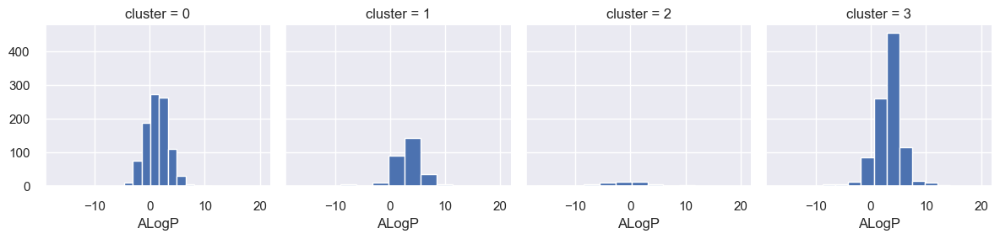

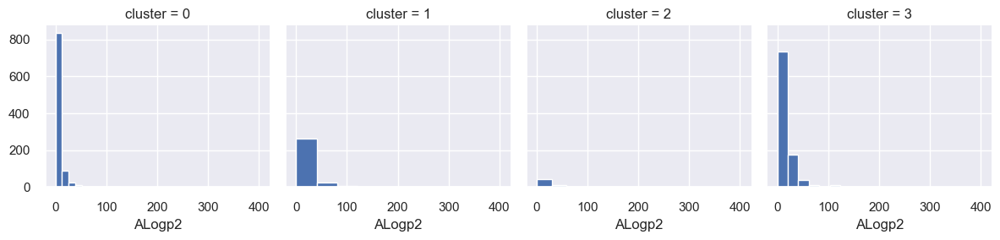

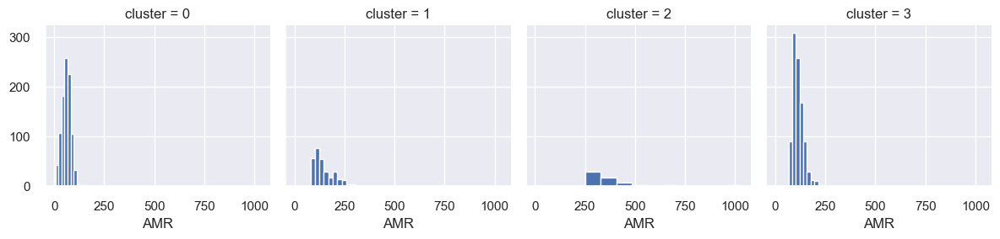

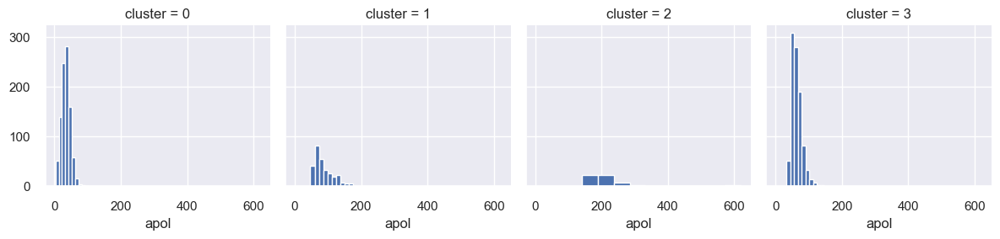

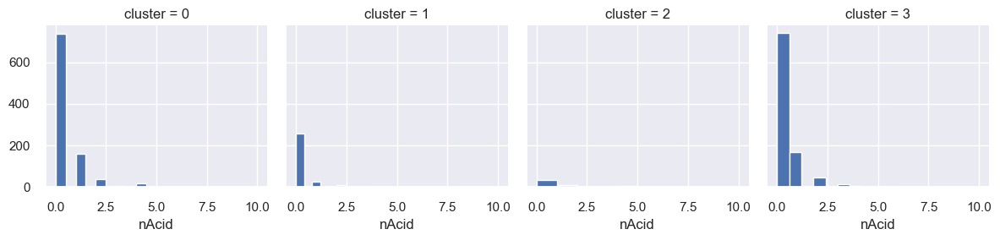

...

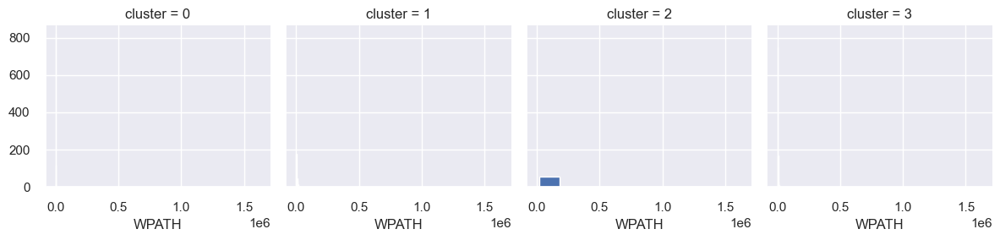

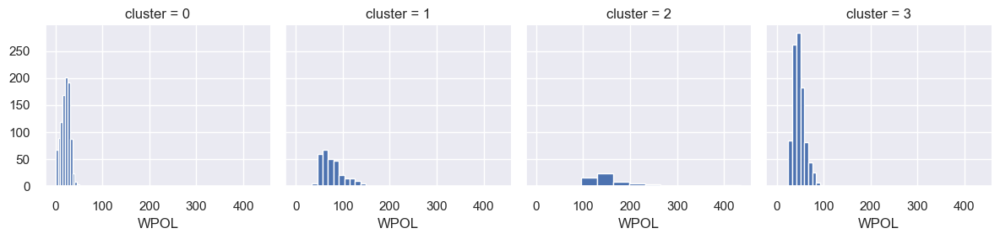

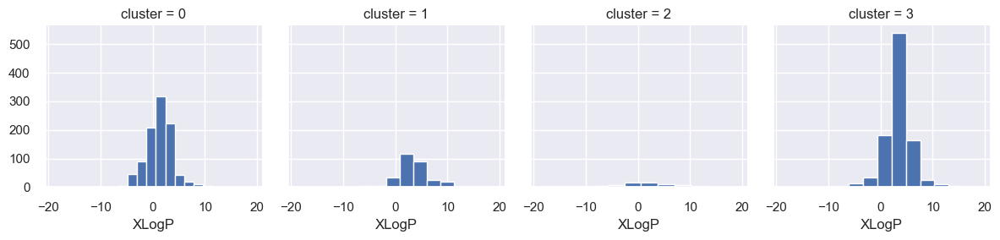

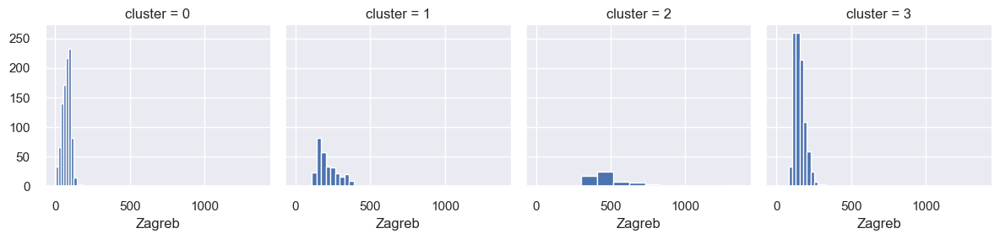

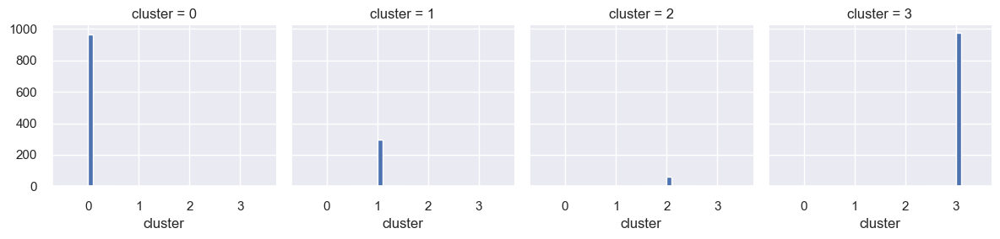

In [44]:
for c in clusters:
    grid = sns.FacetGrid(clusters, col="cluster")
    grid.map(plt.hist, c)
    plt.show()

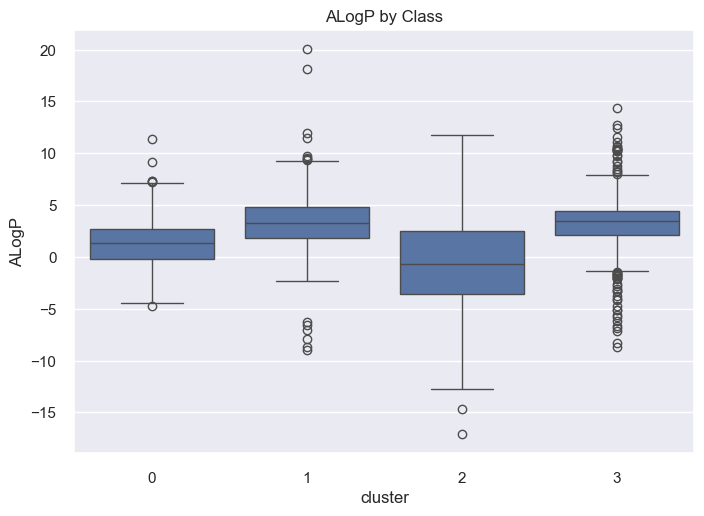

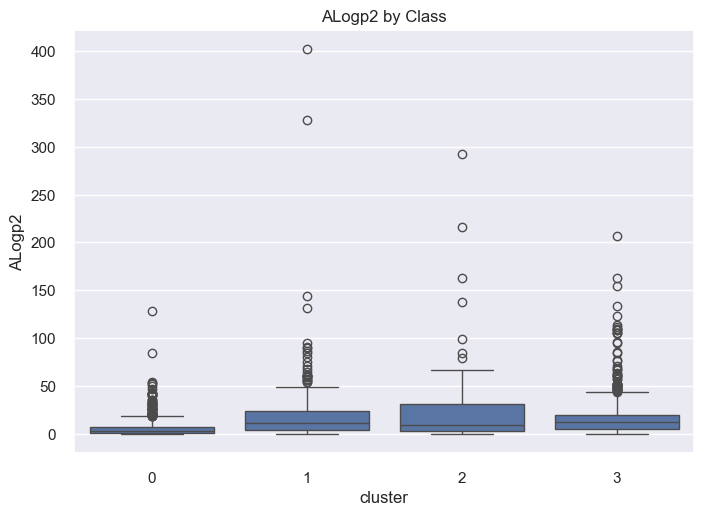

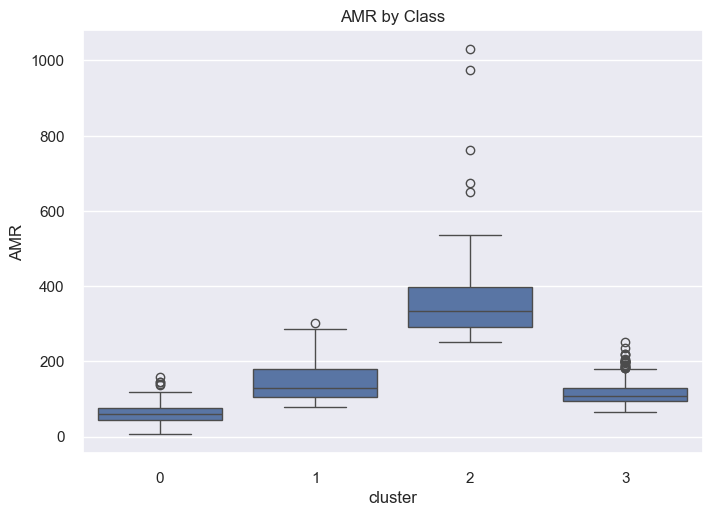

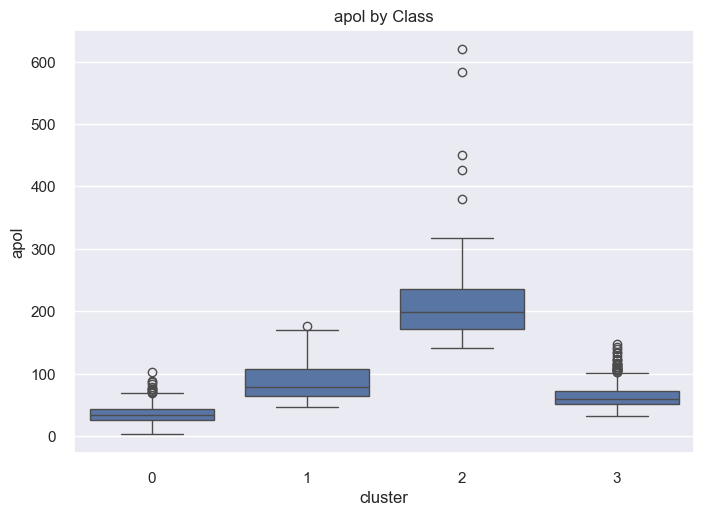

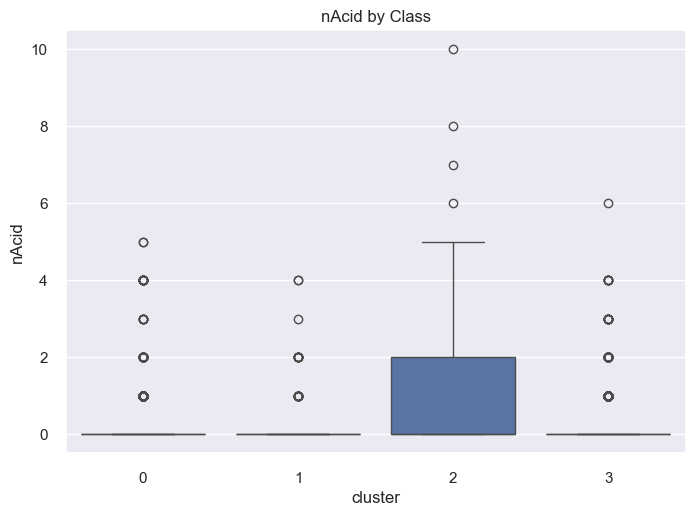

...

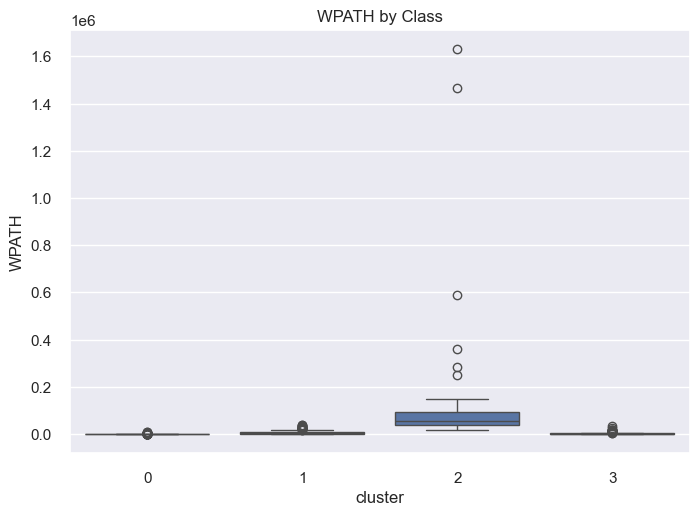

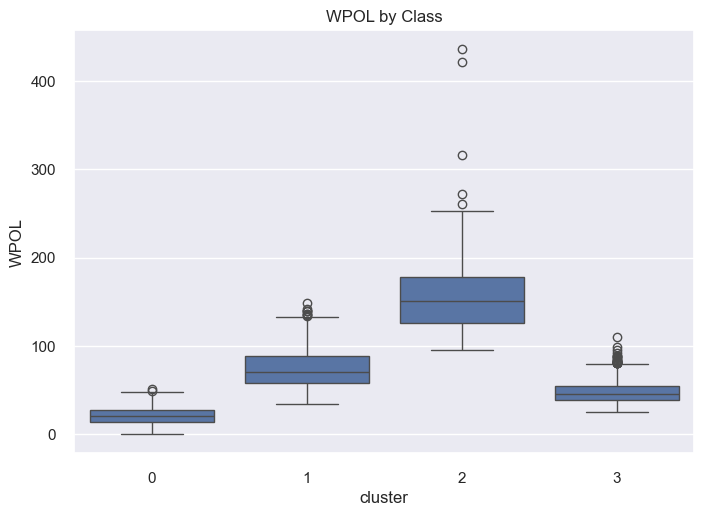

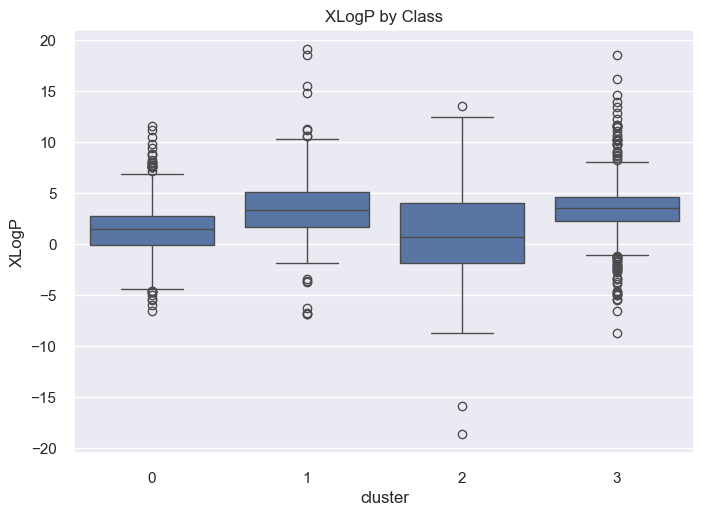

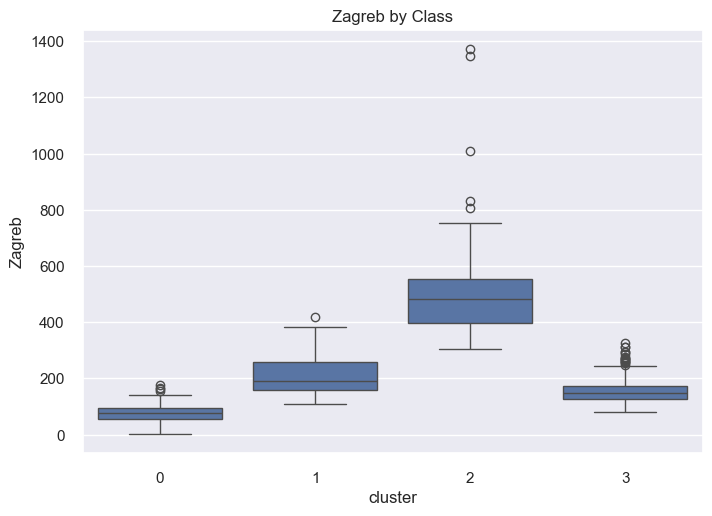

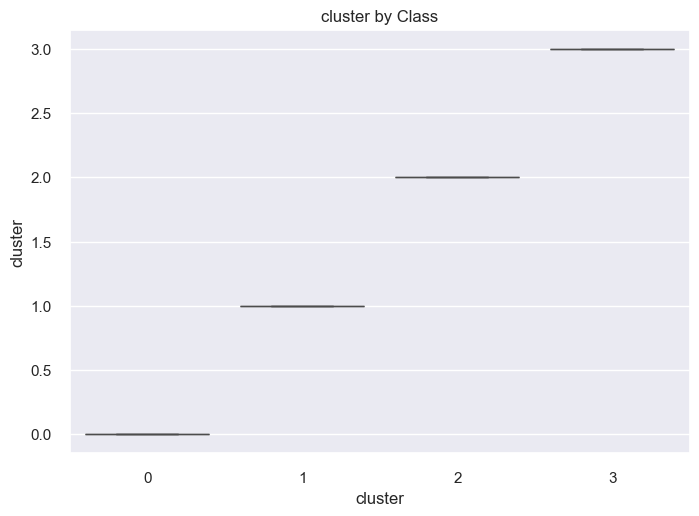

In [45]:
for col in clusters.columns:
    if col == "cluster":
        pass
    sns.boxplot(data=clusters, x='cluster', y=col)
    plt.title("{} by Class".format(col))
    plt.show()

### 2 Components

In [46]:
# using pca with 2 components to visualize our scaled data with clusters
components = 2

# initilizing and fitting the pca
pca = PCA(n_components=components)
X_pca = pca.fit_transform(X_scaled)
pca.n_components_

2

In [47]:
kmean = KMeans(4, n_init=10, max_iter=1000)
kmean.fit(X_pca)
labels = kmean.labels_

In [48]:
silhouette_score(without_compound, labels)

0.3388544836498261

Explained variance ratio [0.78915463 0.21084537]

nSum of Explained variance ratio 1.0

Columns chosen by PCA {'PC1': 'ALogP', 'PC2': 'ALogp2'}


Text(0.5, 1.0, 'Compounds Clustering - All Features')

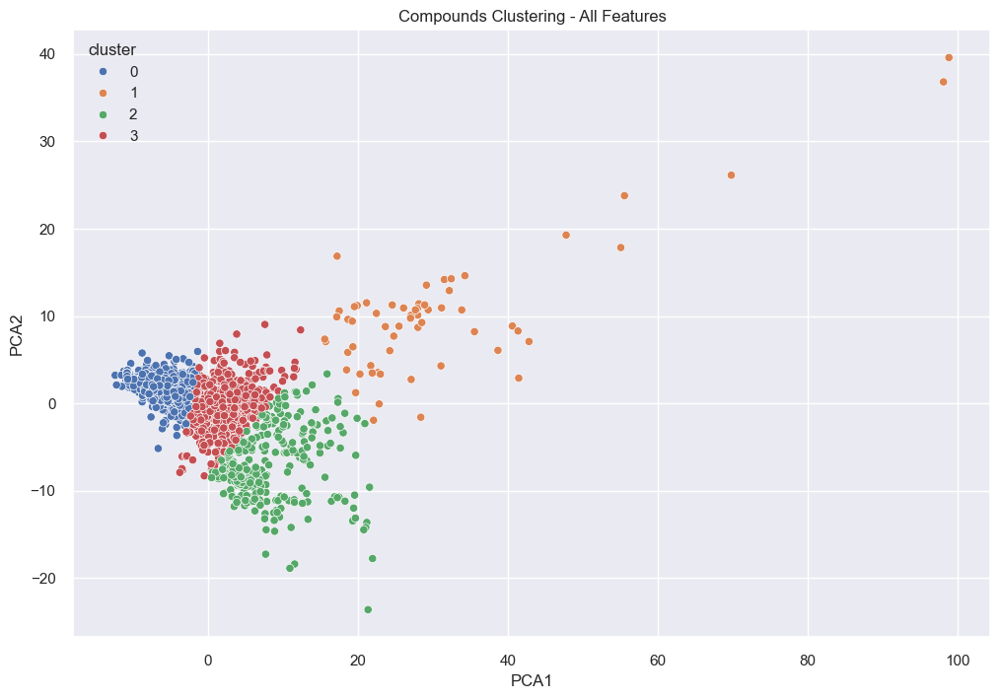

In [49]:
# using pca with 2 components to visualize our scaled data with clusters
components = 2

# initilizing and fitting the pca
pca = PCA(n_components=components)
X_pca = pca.fit_transform(X_pca)

# making dataframe for our pca components
pca_df = pd.DataFrame(X_pca, columns=['PCA1','PCA2'])

# adding cluster assignment
pca_df['cluster'] = pd.Categorical(kmean.labels_)

# adding compound name to this dataframe
# pca_df['compound'] = data['Name']

# get the index of the most important feature on EACH component i.e. largest absolute value
most_important = [np.abs(pca.components_[i]).argmax() for i in range(components)]

# columns/ features of our data
initial_feature_names = without_compound.columns

# get the names
most_important_names = [initial_feature_names[most_important[i]] for i in range(components)]

# using LIST COMPREHENSION HERE AGAIN
dic = {'PC{}'.format(i + 1): most_important_names[i] for i in range(components)}

# explained variance
print("Explained variance ratio", pca.explained_variance_ratio_)
print("\nnSum of Explained variance ratio", pca.explained_variance_ratio_.sum())
print("\nColumns chosen by PCA", dic)


pca_df

# Adjust the figure size
plt.figure(figsize=(12, 8))
# Create the scatterplot using Seaborn
sns.scatterplot(data=pca_df, x='PCA1', y='PCA2', hue="cluster")

# Set the plot title
plt.title("Compounds Clustering - All Features")

# fig = px.scatter(pca_df, x='PCA1', y='PCA2', color="cluster", title="Compounds Clustering - 2 Components PCA", width=800)

# # saving the figure in html file
# # fig.write_html("cluster4.html")

# fig.show()

In [50]:
# adding clusters to our data
clusters = pd.concat([without_compound, pd.DataFrame({'cluster': labels})], axis=1)
clusters.head(3)

,ALogP,ALogp2,AMR,apol,nAcid,naAromAtom,nAromBond,nAtom,ATSc1,ATSc2,...,WTPT-1,WTPT-2,WTPT-3,WTPT-4,WTPT-5,WPATH,WPOL,XLogP,Zagreb,cluster
0,-5.0931,25.939668,534.3813,317.363434,6,18,18,293,5.125258,-2.388694,...,306.516036,1.977523,153.543080,82.176355,71.366725,286334.0,230.0,-8.623,752.0,1
1,0.4325,0.187056,317.0896,187.074612,0,20,21,171,2.269431,-1.093604,...,174.200943,2.002310,78.030370,30.548034,47.482336,46759.0,130.0,1.134,436.0,1
2,-1.8743,3.513000,325.6625,190.878612,0,20,21,175,2.635543,-1.251529,...,181.809125,1.997902,88.729976,35.878826,52.851150,52357.0,134.0,-2.012,458.0,1


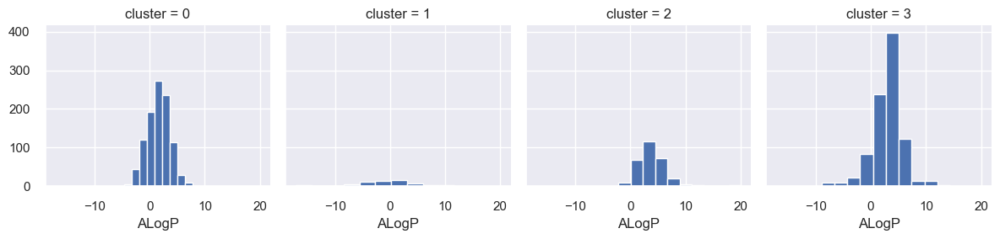

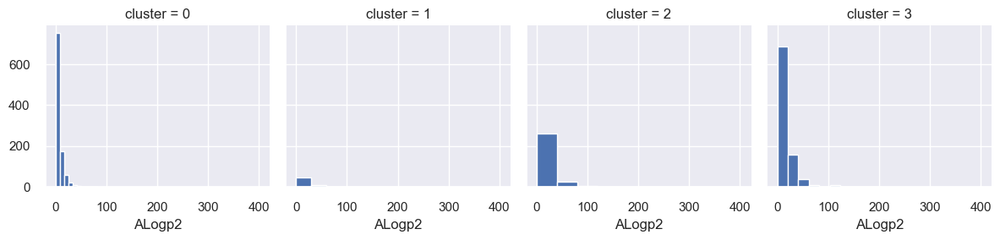

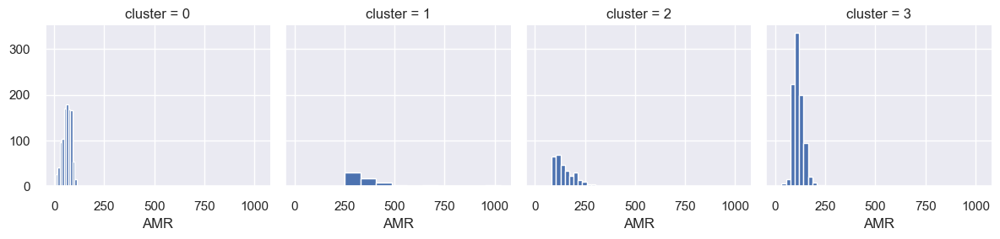

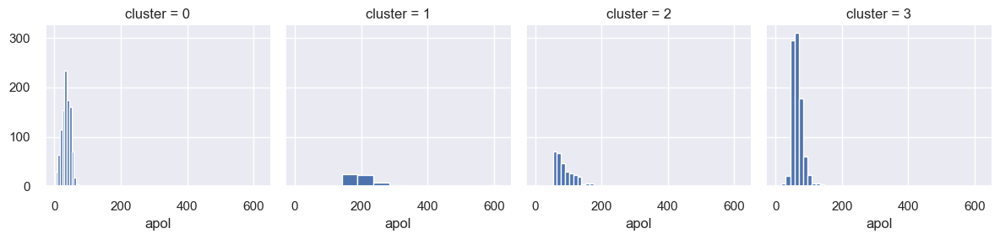

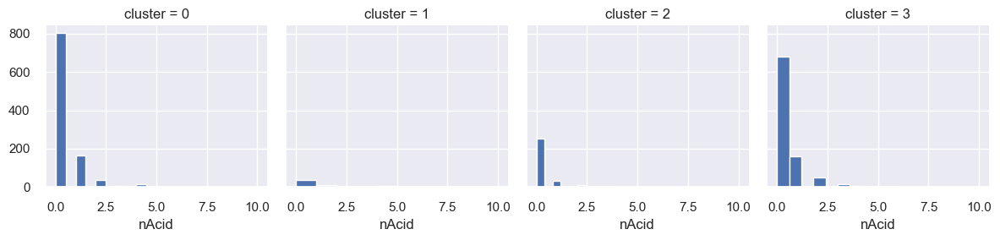

...

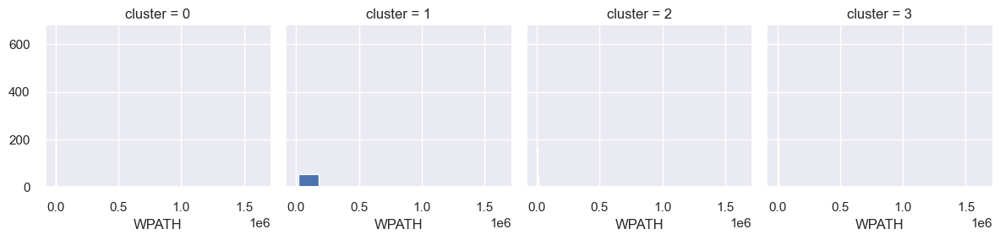

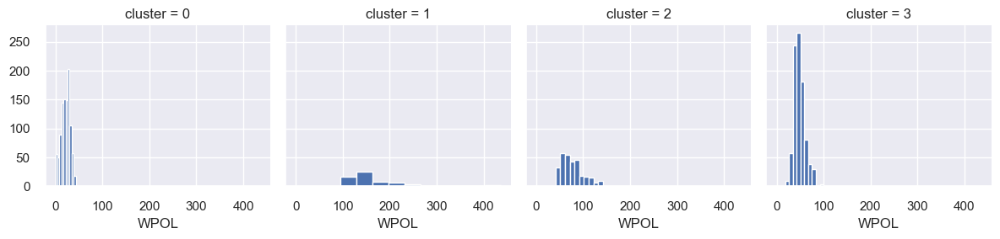

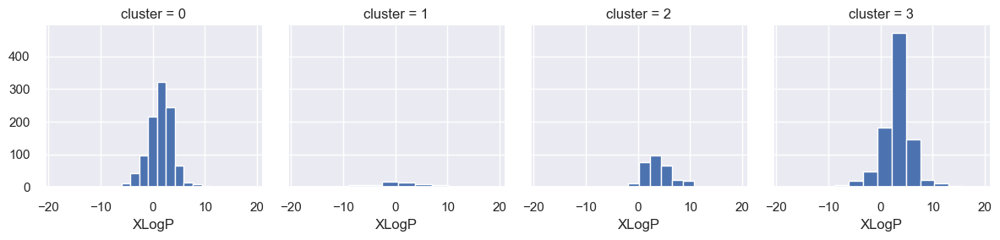

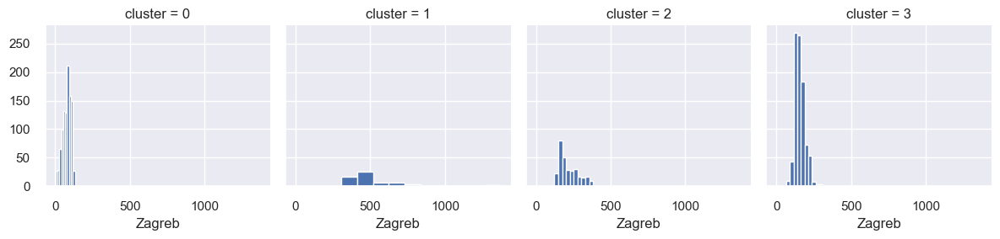

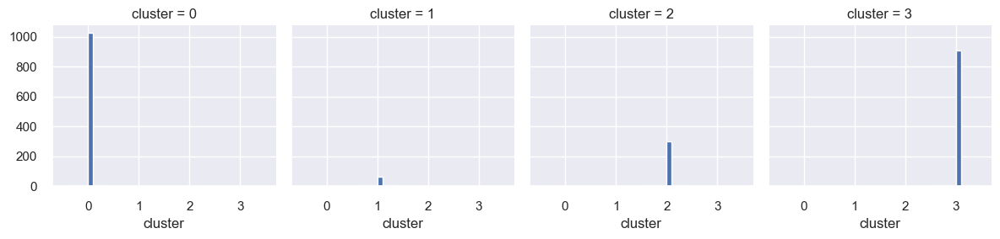

In [51]:
for c in clusters:
    grid = sns.FacetGrid(clusters, col="cluster")
    grid.map(plt.hist, c)
    plt.show()

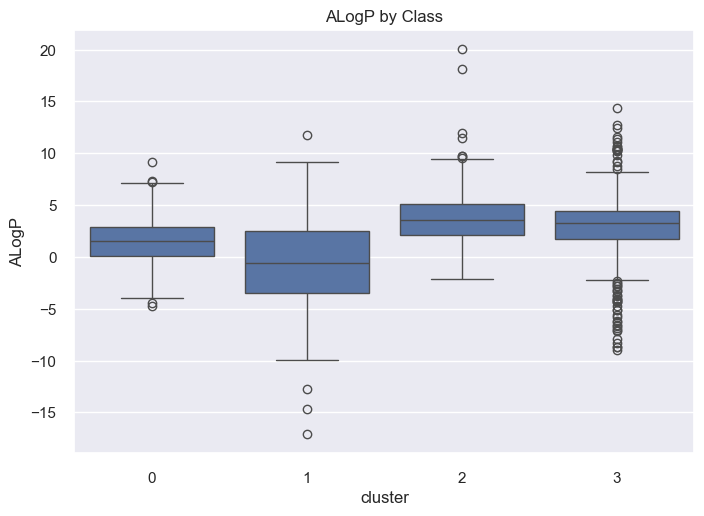

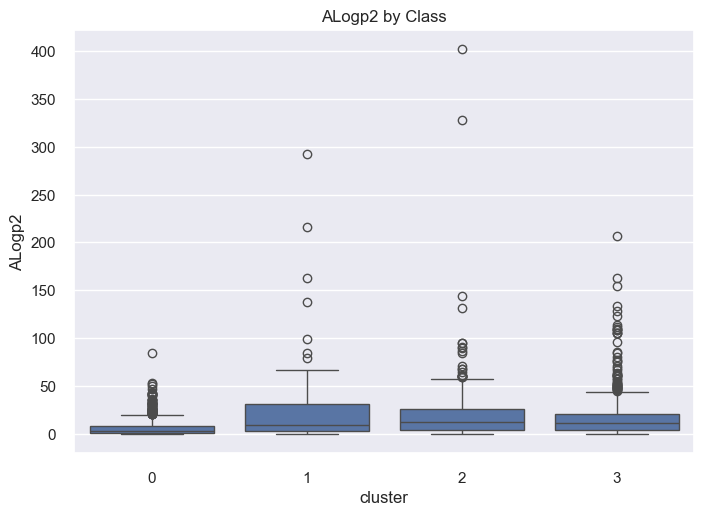

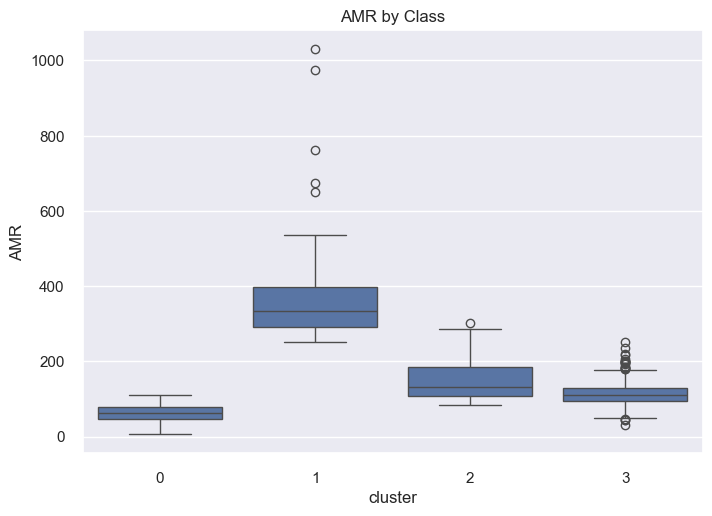

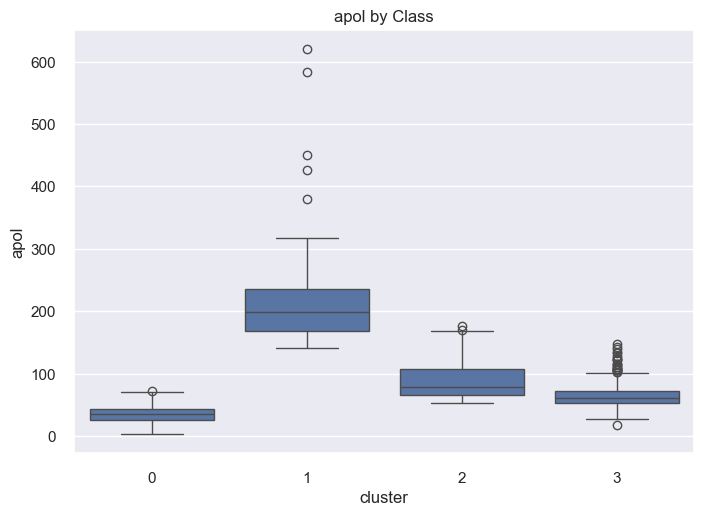

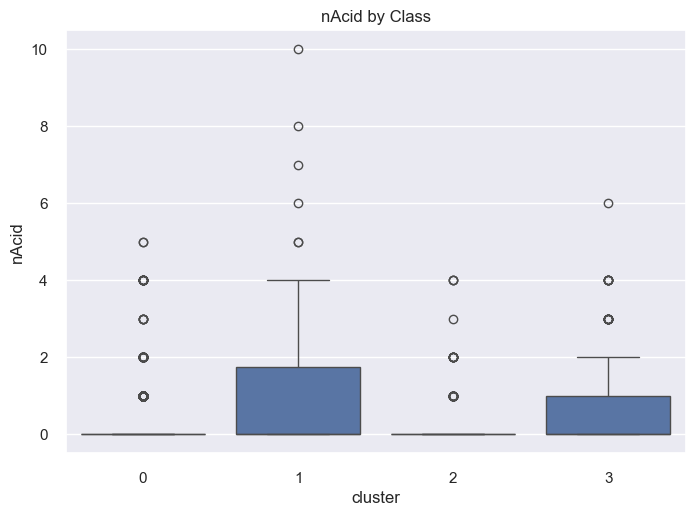

...

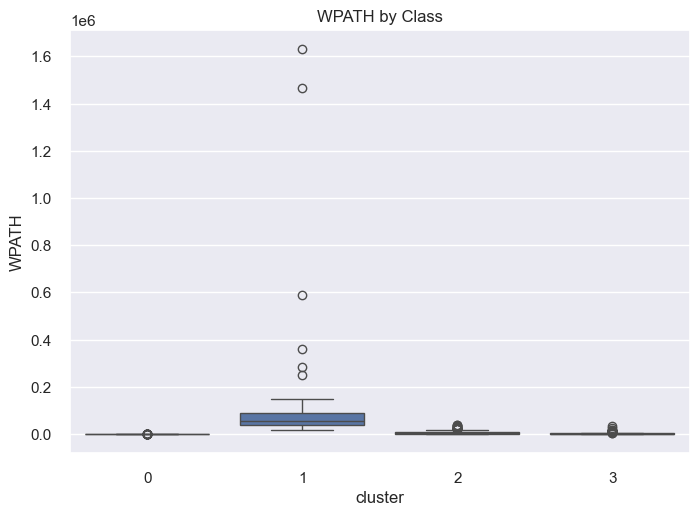

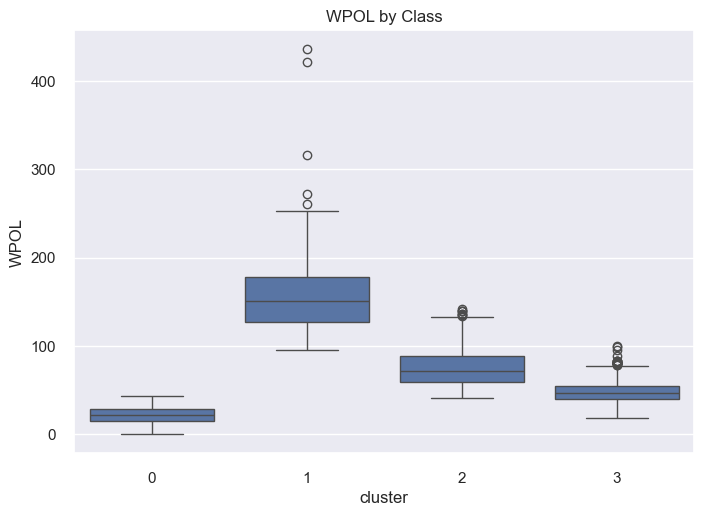

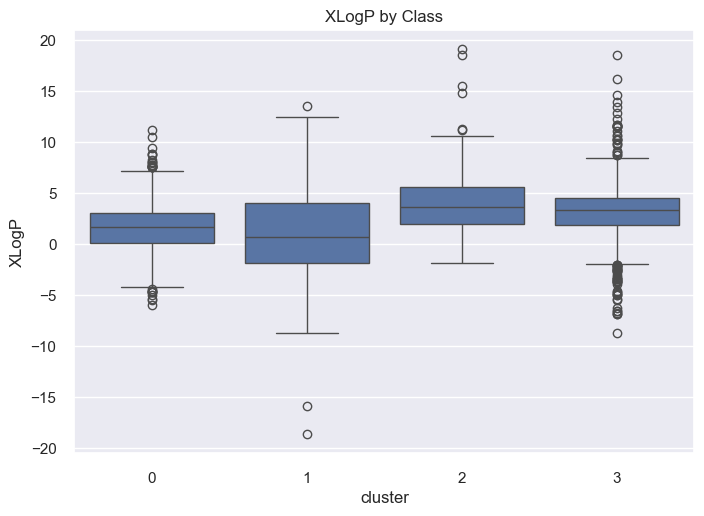

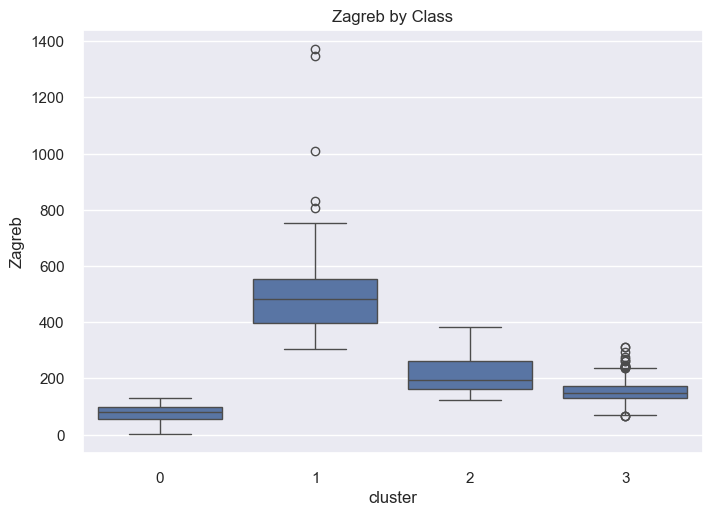

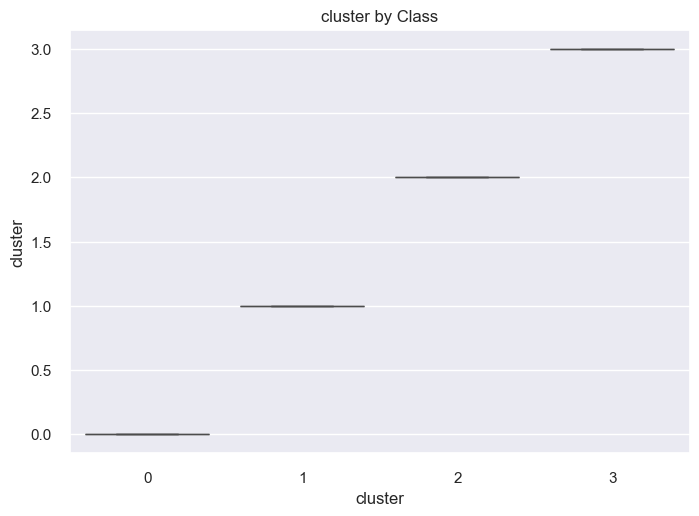

In [52]:
for col in clusters.columns:
    if col == "cluster":
        pass
    sns.boxplot(data=clusters, x='cluster', y=col)
    plt.title("{} by Class".format(col))
    plt.show()

In [53]:
# jupyter nbconvert --execute --to html clustering.ipynb